# ENCI 619.4: Integration of Traffic Volume, Traffic Incidents, Calgary Transit Routes and Bus Only Lane Datasets

## Data Analysis and Transformation: Adding Volumes and Incidents to Routes
Basically, over here we are going to analyze each geojson file and make one csv to tally traffic and incidents along each route. 

In [1]:
"""
ANALYSIS PIPELINE FOR CALGARY TRANSIT ROUTE IMPACT ASSESSMENT

This script analyzes Calgary transit routes by correlating them with traffic volume data
and nearby traffic incidents. It then exports the results to a CSV file for further analysis.

The script uses geospatial analysis techniques to determine spatial relationships between
different datasets, providing insights into the impact of traffic and incidents on transit routes.
"""

import json
import csv
import shapely.geometry
from shapely.geometry import Point, LineString, MultiLineString

# ---------------------------
# GEOSPATIAL ANALYSIS FUNCTIONS
# ---------------------------

def point_near_line(point, line, threshold=0.001):
    """
    Determines if a point is within a specified distance of a line.
    
    Args:
    point (Point): A Shapely Point object representing the incident location.
    line (LineString): A Shapely LineString object representing the transit route.
    threshold (float): The maximum distance (in degrees) to consider the point "near" the line.
                       Default is 0.001, which is approximately 100 meters at Calgary's latitude.
    
    Returns:
    bool: True if the point is within the threshold distance of the line, False otherwise.
    """
    return point.distance(line) < threshold

def lines_intersect_or_close(line1, line2, threshold=0.001):
    """
    Checks if two lines intersect or are close to each other.
    
    Args:
    line1, line2 (LineString): Shapely LineString objects to compare.
    threshold (float): The maximum distance to consider lines "close" if not intersecting.
    
    Returns:
    bool: True if lines intersect or are within the threshold distance, False otherwise.
    
    Note: This function first checks for direct intersection, which is computationally efficient.
    If no intersection is found, it samples points along line1 to check proximity to line2.
    This approach balances accuracy with performance, especially for complex route geometries.
    """
    # Check for direct intersection first (most efficient)
    if line1.intersects(line2):
        return True
    
    # If no direct intersection, sample points along line1 to check proximity
    for i in range(10):  # 10 points are sampled as a balance between accuracy and performance
        distance = i / 10.0  # Normalized distance along the line (0 to 1)
        point = line1.interpolate(distance, normalized=True)
        if point.distance(line2) < threshold:
            return True
    
    return False

# ---------------------------
# DATA LOADING SECTION
# ---------------------------

# Load Calgary Transit Routes
# GeoJSON format is used as it's a standard format for geospatial data
with open('Calgary_Transit_Routes_clean.geojson', 'r') as f:
    transit_routes_data = json.load(f)

# Load Traffic Volume data
with open('Traffic-Volume.geojson', 'r') as f:
    traffic_volume_data = json.load(f)

# Load Traffic Incidents data
with open('Traffic-Incidents.geojson', 'r') as f:
    traffic_incidents_data = json.load(f)

# ---------------------------
# DATA PROCESSING PIPELINE
# ---------------------------

# Process transit routes
transit_routes = []
for feature in transit_routes_data["features"]:
    properties = feature["properties"]
    geometry = feature["geometry"]
    
    # Skip routes without necessary naming information
    # This ensures data integrity and prevents errors in later analysis
    if "ROUTE_SHORT_NAME" not in properties or "ROUTE_LONG_NAME" not in properties:
        continue
    
    route_data = {
        "route_short_name": properties["ROUTE_SHORT_NAME"],
        "route_long_name": properties["ROUTE_LONG_NAME"],
        "geometry": shapely.geometry.shape(geometry),  # Convert GeoJSON to Shapely object for spatial operations
        "traffic_volume": 0,  # Initialize traffic volume counter
        "incidents": 0  # Initialize incident counter
    }
    
    transit_routes.append(route_data)

# Process traffic volume data
traffic_sections = []
for feature in traffic_volume_data["features"]:
    properties = feature["properties"]
    geometry = feature["geometry"]
    
    # Skip sections without volume data to ensure data quality
    if "Volume" not in properties:
        continue
    
    # Clean and convert volume to integer
    # Remove commas and convert to int to handle various input formats
    volume_str = str(properties["Volume"]).replace(",", "")
    try:
        volume = int(volume_str)
    except ValueError:
        # Log warning for invalid data but continue processing
        print(f"Warning: Invalid volume value: {properties['Volume']}")
        continue
    
    section_data = {
        "section_name": properties.get("Section Name", "Unknown"),  # Use "Unknown" if name is missing
        "volume": volume,
        "geometry": shapely.geometry.shape(geometry)  # Convert to Shapely object for spatial analysis
    }
    
    traffic_sections.append(section_data)

# Process traffic incidents
traffic_incidents = []
for feature in traffic_incidents_data["features"]:
    properties = feature["properties"]
    geometry = feature["geometry"]
    
    incident_data = {
        "info": properties.get("INCIDENT INFO", ""),  # Use empty string if info is missing
        "description": properties.get("DESCRIPTION", ""),  # Use empty string if description is missing
        "geometry": shapely.geometry.shape(geometry)  # Convert to Shapely object for spatial analysis
    }
    
    traffic_incidents.append(incident_data)

# ---------------------------
# SPATIAL ANALYSIS ENGINE
# ---------------------------

print(f"Processing {len(transit_routes)} transit routes...")
for i, route in enumerate(transit_routes):
    route_geometry = route["geometry"]
    print(f"\nAnalyzing Route: {route['route_short_name']} - {route['route_long_name']}")
    print(f"Route Geometry Type: {type(route_geometry).__name__}")
    
    # Check against traffic volume sections
    for section in traffic_sections:
        section_geometry = section["geometry"]
        
        # If the route and section intersect or are close, add the volume
        if lines_intersect_or_close(route_geometry, section_geometry):
            route["traffic_volume"] += section["volume"]
            print(f"  Traffic Volume Match:")
            print(f"    Section: {section['section_name']}")
            print(f"    Volume: {section['volume']}")
            print(f"    Intersection Point: {route_geometry.intersection(section_geometry)}")
    
    # Check against traffic incidents
    for incident in traffic_incidents:
        incident_point = incident["geometry"]
        
        # If the incident is near the route, increment the count
        if point_near_line(incident_point, route_geometry):
            route["incidents"] += 1
            print(f"  Incident Match:")
            print(f"    Info: {incident['info']}")
            print(f"    Location: {incident_point.coords[0]}")
    
    print(f"  Total Traffic Volume: {route['traffic_volume']}")
    print(f"  Total Incidents: {route['incidents']}")
    
    # Print progress every 10 routes
    if (i + 1) % 10 == 0:
        print(f"Processed {i + 1}/{len(transit_routes)} routes")

# ---------------------------
# OUTPUT GENERATION
# ---------------------------

# Prepare output data
# Create a list of dictionaries, each representing a route with its analyzed data
output_data = []
for route in transit_routes:
    output_data.append({
        "Route_Short_Name": route["route_short_name"],
        "Route_Long_Name": route["route_long_name"],
        "Traffic_Volume": route["traffic_volume"],
        "Incidents": route["incidents"]
    })

# Write to CSV
with open('ztransit_route_analysis-debug.csv', 'w', newline='') as csvfile:
    fieldnames = ['Route_Short_Name', 'Route_Long_Name', 'Traffic_Volume', 'Incidents']
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    
    writer.writeheader()
    for row in output_data:
        writer.writerow(row)

print(f"Analysis complete. Data saved to transit_route_analysis.csv")


Processing 151 transit routes...

Analyzing Route: 38 - Brentwood Station/Temple
Route Geometry Type: MultiLineString
  Traffic Volume Match:
    Section: CRWCHLD10
    Volume: 72000
    Intersection Point: MULTIPOINT ((-114.12580174212779 51.082912456001274), (-114.12591054600856 51.08300250671274))
  Traffic Volume Match:
    Section: DEERFOOT5
    Volume: 146750
    Intersection Point: POINT (-114.03381763251278 51.08154208439062)
  Traffic Volume Match:
    Section: DEERFOOT6
    Volume: 146580
    Intersection Point: POINT (-114.0336890174824 51.081423469688715)
  Incident Match:
    Info: Edmonton Trail and 41 Avenue NE
    Location: (-114.0526863, 51.08969097)
  Incident Match:
    Info:  32 Avenue and 29 Street NE 
    Location: (-113.99182017835014, 51.08155108585583)
  Incident Match:
    Info:  Northmount Drive and 14 Street NW 
    Location: (-114.0948265839682, 51.08298263777151)
  Incident Match:
    Info:  32 Avenue and Deerfoot Trail NE 
    Location: (-114.033233914286

### Old

In [ ]:
# import pandas as pd
# import json
# import re
# import csv
# from math import radians, sin, cos, sqrt, atan2

# # Function to calculate the distance between two points using the Haversine formula
# def haversine_distance(lat1, lon1, lat2, lon2):
#     # Radius of Earth in kilometers
#     R = 6371.0
    
#     # Convert degrees to radians
#     lat1_rad = radians(float(lat1))
#     lon1_rad = radians(float(lon1))
#     lat2_rad = radians(float(lat2))
#     lon2_rad = radians(float(lon2))
    
#     # Differences
#     dlon = lon2_rad - lon1_rad
#     dlat = lat2_rad - lat1_rad
    
#     # Haversine formula
#     a = sin(dlat / 2)**2 + cos(lat1_rad) * cos(lat2_rad) * sin(dlon / 2)**2
#     c = 2 * atan2(sqrt(a), sqrt(1 - a))
#     distance = R * c
    
#     # Return distance in kilometers
#     return distance

# # Load CSV data
# bus_lanes_df = pd.read_csv('Manual-BusLane-Processed.csv')

# # Clean up the CSV data - filter out invalid coordinates
# valid_lanes = bus_lanes_df[(bus_lanes_df['From_Lat'] != 'Invalid') & 
#                            (bus_lanes_df['From_Lon'] != 'Invalid') &
#                            (bus_lanes_df['From_Lat'] != 'unknown') & 
#                            (bus_lanes_df['From_Lon'] != 'unknown')]

# # Create a list of valid bus lane coordinates
# bus_lane_coords = []
# for _, lane in valid_lanes.iterrows():
#     try:
#         lat = float(lane['From_Lat'])
#         lon = float(lane['From_Lon'])
#         bus_lane_coords.append((lat, lon))
#     except (ValueError, TypeError):
#         continue

# # Parse the GeoJSON text
# geojson_text = """
# {
# "type": "FeatureCollection",
# "name": "Calgary_Transit_Routes",
# "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" } },
# "features": [
# { "type": "Feature", "properties": { "ROUTE_CATEGORY": "REGULAR", "ROUTE_SHORT_NAME": 101, "ROUTE_LONG_NAME": "Inglewood", "CREATE_DT_UTC": "2025/03/04", "MOD_DT_UTC": "2025/03/04", "GLOBALID": "66de36cd-58ee-4eec-8cf2-b532e2333f11", "MULTILINESTRING": "MULTILINESTRING ((-114.055508 51.047236, -114.054345 51.047204), (-114.053061 51.047157, -114.054015 51.047192, -114.054345 51.047204, -114.054029 51.047192, -114.053061 51.047157), (-114.053061 51.047157, -114.052309 51.047134), (-114.050604 51.047086, -114.052309 51.047134, -114.051003 51.047097, -114.050604 51.047086), (-114.048919 51.047038, -114.050604 51.047086, -114.050298 51.047077, -114.048919 51.047038), (-114.048919 51.047038, -114.048345 51.047021, -114.048345 51.046547, -114.048346 51.046072, -114.048359 51.045595), (-114.048347 51.045115, -114.048359 51.045595, -114.048357 51.045514, -114.048347 51.045115), (-114.06557 51.044681, -114.065528 51.045135, -114.065504 51.045603, -114.065469 51.046087, -114.065431 51.046404, -114.065412 51.046566, -114.065379 51.047041, -114.065349 51.04753, -114.064222 51.047489, -114.063558 51.047464, -114.062868 51.047445, -114.060435 51.047376, -114.059968 51.047362, -114.057976 51.047306, -114.057475 51.047291, -114.057334 51.047288, -114.055508 51.047236, -114.055461 51.047913, -114.055445 51.0482, -114.05554 51.048192, -114.055743 51.048181, -114.05605 51.048182, -114.056549 51.048192, -114.056769 51.048199, -114.057362 51.04822, -114.057908 51.048249, -114.060366 51.048319, -114.061855 51.048362, -114.062799 51.048389, -114.065301 51.048459, -114.065336 51.047791, -114.065349 51.04753, -114.067833 51.047585, -114.068476 51.047594, -114.069097 51.047615, -114.069705 51.047632, -114.069876 51.047636, -114.070247 51.047645, -114.07148 51.047688, -114.073746 51.047752, -114.07378 51.047273, -114.073813 51.046821, -114.073807 51.046424, -114.073806 51.046325, -114.073882 51.045839, -114.07389 51.045378, -114.073862 51.045321, -114.073842 51.045262, -114.073832 51.045205, -114.073854 51.044901, -114.072084 51.044846, -114.071837 51.044834, -114.07152,51.044829, -114.071257 51.044813, -114.070479 51.0448, -114.068876 51.044768, -114.068035 51.044751, -114.06557 51.044681), (-114.048343 51.044045, -114.048345 51.044711, -114.048347 51.045115, -114.048343 51.044045), (-114.048343 51.044045, -114.047936 51.043996, -114.047706 51.043976, -114.047478 51.043961, -114.047067 51.043944, -114.046826 51.043938, -114.046503 51.043927, -114.045646 51.043903), (-114.044451 51.043866, -114.045646 51.043903, -114.045492 51.043898, -114.044451 51.043866), (-114.044451 51.043866, -114.04409 51.043862, -114.043717 51.043849, -114.043666 51.043841, -114.04362 51.043832, -114.043109 51.043722, -114.042828 51.043655, -114.042322 51.043533, -114.042119 51.043488, -114.041469 51.043329), (-114.040277 51.043045, -114.040881 51.043189, -114.041469 51.043329, -114.040277 51.043045), (-114.040045 51.042988, -114.040277 51.043045, -114.040216 51.04303, -114.040045 51.042988), (-114.040045 51.042988, -114.039458 51.042848, -114.037853 51.042463, -114.036904 51.042237, -114.036768 51.042195), (-114.034347 51.041254, -114.034873 51.041459, -114.036768 51.042195, -114.034347 51.041254), (-114.03166 51.04021, -114.033918 51.041088, -114.034347 51.041254, -114.03166 51.04021), (-114.028973 51.039166, -114.03166 51.04021, -114.029423 51.03934, -114.028973 51.039166), (-114.027902 51.038749, -114.028477 51.038973, -114.028973 51.039166, -114.027902 51.038749), (-114.027902 51.038749, -114.027245 51.038494, -114.025516 51.037822, -114.025175 51.03769, -114.025133 51.037673, -114.024705 51.037507), (-114.0245748 51.0374564, -114.024705 51.037507, -114.024584 51.03746, -114.0245748 51.0374564), (-114.023493 51.037037, -114.0245748 51.0374564, -114.024378 51.03738, -114.023493 51.037037), (-114.023493 51.037037, -114.023198 51.036919, -114.022785 51.036731, -114.022138 51.036431, -114.022023 51.036378, -114.021957 51.036347), (-114.021387 51.036083, -114.021957 51.036347, -114.021491 51.036131, -114.021387 51.036083), (-114.020264 51.035563, -114.021088 51.035945, -114.021387 51.036083, -114.020264 51.035563), (-114.020264 51.035563, -114.019952 51.035418), (-114.01909 51.035028, -114.019476 51.035204, -114.019952 51.035418, -114.01909 51.035028), (-114.01909 51.035028, -114.018825 51.034905), (-114.017983 51.034516, -114.018423 51.03472, -114.018825 51.034905, -114.017983 51.034516), (-114.017983 51.034516, -114.018429 51.034135), (-114.019141 51.033494, -114.018429 51.034135, -114.018454 51.034113, -114.019141 51.033494), (-114.019141 51.033494, -114.019142 51.0331), (-114.019144 51.031942, -114.019143 51.032265, -114.019142 51.0331, -114.019144 51.031942), (-114.019144 51.030851, -114.019143 51.031591, -114.019144 51.031942, -114.019144 51.030869, -114.019144 51.030851), (-114.019144 51.030851, -114.019138 51.030491), (-114.019141 51.02894, -114.019138 51.030203, -114.019138 51.030491, -114.019141 51.02894), (-114.01807 51.02894, -114.017899 51.028935, -114.017763 51.028833, -114.017492 51.028826, -114.017361 51.028876, -114.017311 51.028974, -114.017335 51.029056, -114.017516 51.029114, -114.017645 51.029118, -114.017802 51.029104, -114.017919 51.029062, -114.017979 51.029018, -114.017995 51.028992, -114.01807 51.02894, -114.018324 51.02894, -114.018433 51.02894, -114.019141 51.02894))" }, "geometry": { "type": "MultiLineString", "coordinates": [ [ [ -114.055508, 51.047236 ], [ -114.054345, 51.047204 ] ], [ [ -114.053061, 51.047157 ], [ -114.054015, 51.047192 ], [ -114.054345, 51.047204 ], [ -114.054029, 51.047192 ], [ -114.053061, 51.047157 ] ], [ [ -114.053061, 51.047157 ], [ -114.052309, 51.047134 ] ] ] } }
# ]
# }
# """

# # Use regex to extract the complete JSON object as the pasted text might be incomplete
# geojson_str = re.search(r'(\{[\s\S]*"features":\s*\[[\s\S]*\]\s*\})', geojson_text).group(1)

# # Fix the incomplete JSON if necessary
# if not geojson_str.endswith('}'):
#     geojson_str += '}'

# # Parse the JSON data
# try:
#     geojson_data = json.loads(geojson_str)
# except json.JSONDecodeError:
#     # If there's an issue with JSON parsing, try a different approach
#     # by directly extracting the route information and coordinates
#     routes_data = []
#     routes_pattern = r'"ROUTE_SHORT_NAME":\s*(\d+),\s*"ROUTE_LONG_NAME":\s*"([^"]*)"'
#     multilinestring_pattern = r'"MULTILINESTRING":\s*"(MULTILINESTRING\s*\([^)]*\))"'
    
#     for route_match, multiline_match in zip(
#         re.finditer(routes_pattern, geojson_text),
#         re.finditer(multilinestring_pattern, geojson_text)
#     ):
#         route_short_name = route_match.group(1)
#         route_long_name = route_match.group(2)
#         multilinestring = multiline_match.group(1)
        
#         routes_data.append({
#             'ROUTE_SHORT_NAME': route_short_name,
#             'ROUTE_LONG_NAME': route_long_name,
#             'MULTILINESTRING': multilinestring
#         })
# else:
#     # If JSON parsing was successful, extract the route information
#     routes_data = []
#     for feature in geojson_data.get('features', []):
#         properties = feature.get('properties', {})
#         route_short_name = properties.get('ROUTE_SHORT_NAME')
#         route_long_name = properties.get('ROUTE_LONG_NAME')
#         multilinestring = properties.get('MULTILINESTRING')
        
#         if route_short_name and route_long_name and multilinestring:
#             routes_data.append({
#                 'ROUTE_SHORT_NAME': route_short_name,
#                 'ROUTE_LONG_NAME': route_long_name,
#                 'MULTILINESTRING': multilinestring
#             })

# # Extract coordinates from MULTILINESTRING for each route
# def extract_coordinates(multilinestring):
#     coord_pairs = re.findall(r'(-?\d+\.\d+)\s+(-?\d+\.\d+)', multilinestring)
#     return [(float(lat), float(lon)) for lon, lat in coord_pairs]

# # Process each route to count bus lanes
# route_bus_lanes = []
# for route in routes_data:
#     route_short_name = route['ROUTE_SHORT_NAME']
#     route_long_name = route['ROUTE_LONG_NAME']
#     route_coords = extract_coordinates(route['MULTILINESTRING'])
    
#     # Set to track counted bus lanes to avoid duplicates
#     counted_lane_indices = set()
    
#     # Threshold for considering coordinates as "matching" (in kilometers)
#     threshold = 0.1  # 100 meters
    
#     # Check each route coordinate against bus lane coordinates
#     for route_lat, route_lon in route_coords:
#         for i, (lane_lat, lane_lon) in enumerate(bus_lane_coords):
#             # Calculate the distance between points
#             distance = haversine_distance(route_lat, route_lon, lane_lat, lane_lon)
            
#             # If the distance is less than the threshold, consider it a match
#             if distance < threshold and i not in counted_lane_indices:
#                 counted_lane_indices.add(i)
    
#     # Add the result to our list
#     route_bus_lanes.append({
#         'ROUTE_SHORT_NAME': route_short_name,
#         'ROUTE_LONG_NAME': route_long_name,
#         'Number of Bus Only Lanes': len(counted_lane_indices)
#     })

# # Write results to CSV
# with open('route_bus_lanes.csv', 'w', newline='') as csvfile:
#     fieldnames = ['ROUTE_SHORT_NAME', 'ROUTE_LONG_NAME', 'Number of Bus Only Lanes']
#     writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    
#     writer.writeheader()
#     for route_data in route_bus_lanes:
#         writer.writerow(route_data)

# print("Analysis complete. Results saved to 'route_bus_lanes.csv'.")

## Identifying routes with Bus-Only-Lanes

In [2]:
import json
import csv
import math
from collections import defaultdict

def parse_geojson_file(filename):
    """Parse a GeoJSON file to extract route information and coordinates."""
    try:
        with open(filename, 'r') as file:
            data = json.load(file)
        
        routes = []
        
        for feature in data.get('features', []):
            props = feature.get('properties', {})
            route_short_name = props.get('ROUTE_SHORT_NAME')
            route_long_name = props.get('ROUTE_LONG_NAME')
            
            # Extract coordinates from MultiLineString
            coordinates = []
            geometry = feature.get('geometry', {})
            if geometry.get('type') == 'MultiLineString':
                for line in geometry.get('coordinates', []):
                    for coord in line:
                        coordinates.append((float(coord[0]), float(coord[1])))
            
            routes.append({
                'route_short_name': route_short_name,
                'route_long_name': route_long_name,
                'coordinates': coordinates
            })
            
        return routes
    except Exception as e:
        print(f"Error parsing GeoJSON file: {e}")
        return []

def read_bus_lanes_csv(filename):
    """Read the bus lanes CSV file and extract lane information."""
    bus_lanes = []
    
    with open(filename, 'r') as csvfile:
        reader = csv.DictReader(csvfile)
        for row in reader:
            try:
                # Skip entries with invalid coordinates
                from_lat = row.get('From_Lat', '').strip()
                from_lon = row.get('From_Lon', '').strip()
                
                if from_lat in ('Invalid', 'unknown', '') or from_lon in ('Invalid', 'unknown', ''):
                    continue
                
                lane = {
                    'id': row.get('ID Number', ''),
                    'from': row.get('From', ''),
                    'to': row.get('To', ''),
                    'lane_type': row.get('Lane Type', ''),
                    'from_lat': float(from_lat),
                    'from_lon': float(from_lon)
                }
                bus_lanes.append(lane)
            except (ValueError, TypeError):
                # Skip entries that can't be parsed
                continue
    
    return bus_lanes

def is_coordinate_near_route(lat, lon, route_coords, padding=0.0001):
    """Check if a coordinate is near any point on a route."""
    for route_lon, route_lat in route_coords:
        # Calculate the Euclidean distance between points
        distance = math.sqrt((route_lat - lat)**2 + (route_lon - lon)**2)
        if distance <= padding:
            return True
    return False

def count_bus_lanes_on_routes(routes, bus_lanes, padding=0.0001):
    """Count the number of unique bus lanes on each route."""
    results = []
    
    for route in routes:
        route_coords = route['coordinates']
        lane_count = 0
        counted_lanes = set()  # Track IDs to prevent duplicate counting
        
        for lane in bus_lanes:
            lane_id = lane['id']
            if lane_id in counted_lanes:
                continue
                
            if is_coordinate_near_route(lane['from_lat'], lane['from_lon'], route_coords, padding):
                lane_count += 1
                counted_lanes.add(lane_id)
        
        results.append({
            'route_short_name': route['route_short_name'],
            'route_long_name': route['route_long_name'],
            'num_bus_lanes': lane_count
        })
    
    return results

def write_results_to_csv(results, output_filename):
    """Write the results to a CSV file."""
    with open(output_filename, 'w', newline='') as csvfile:
        fieldnames = ['ROUTE_SHORT_NAME', 'ROUTE_LONG_NAME', 'Number of Bus Only Lanes']
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
        
        writer.writeheader()
        for result in results:
            writer.writerow({
                'ROUTE_SHORT_NAME': result['route_short_name'],
                'ROUTE_LONG_NAME': result['route_long_name'],
                'Number of Bus Only Lanes': result['num_bus_lanes']
            })

def main():
    # File paths
    geojson_file = 'Calgary_Transit_Routes_clean.geojson'
    bus_lanes_csv = 'Data Preprocessing\Manual-BusLane-Processed.csv'
    output_csv = 'route_bus_lanes.csv'
    
    # 1. Parse the GeoJSON data
    routes = parse_geojson_file(geojson_file)
    
    # 2. Read the bus lanes CSV
    bus_lanes = read_bus_lanes_csv(bus_lanes_csv)
    
    # 3. Count bus lanes on each route
    results = count_bus_lanes_on_routes(routes, bus_lanes)
    
    # 4. Write results to CSV
    write_results_to_csv(results, output_csv)
    print(f"Analysis complete. Results written to {output_csv}")

if __name__ == "__main__":
    main()

Analysis complete. Results written to route_bus_lanes.csv


# Final Analysis Phase 

### Reviewing output from above

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Set the style for plots
plt.style.use('ggplot')
sns.set_palette('Set2')

# Function to load and analyze the data
def analyze_bus_routes(csv_file):
    # Load the data
    print("Loading data from:", csv_file)
    df = pd.read_csv(csv_file)
    
    # Convert ROUTE_SHORT_NAME to string type to ensure str methods work
    df['ROUTE_SHORT_NAME'] = df['ROUTE_SHORT_NAME'].astype(str)
    
    # Display basic information about the dataset
    print("\n===== BASIC DATASET INFORMATION =====")
    print(f"Total number of bus routes: {len(df)}")
    print(f"Number of routes with bus-only lanes: {len(df[df['Number of Bus Only Lanes'] > 0])}")
    print(f"Percentage of routes with bus-only lanes: {(len(df[df['Number of Bus Only Lanes'] > 0]) / len(df) * 100):.2f}%")
    print(f"Total number of bus-only lanes across all routes: {df['Number of Bus Only Lanes'].sum()}")
    print(f"Average number of bus-only lanes per route: {df['Number of Bus Only Lanes'].mean():.2f}")
    
    # Find routes with the most bus-only lanes
    top_routes = df.sort_values(by='Number of Bus Only Lanes', ascending=False).head(10)
    print("\n===== TOP 10 ROUTES WITH MOST BUS-ONLY LANES =====")
    for idx, row in top_routes.iterrows():
        print(f"Route {row['ROUTE_SHORT_NAME']} ({row['ROUTE_LONG_NAME']}): {int(row['Number of Bus Only Lanes'])} lanes")
    
    # Analyze BRT and MAX routes specifically
    brt_routes = df[df['ROUTE_LONG_NAME'].str.contains('BRT', case=False)]
    max_routes = df[df['ROUTE_LONG_NAME'].str.contains('MAX', case=False)]
    
    print("\n===== BRT AND MAX ROUTES ANALYSIS =====")
    print(f"Number of BRT routes: {len(brt_routes)}")
    print(f"Average bus-only lanes for BRT routes: {brt_routes['Number of Bus Only Lanes'].mean():.2f}")
    print(f"Number of MAX routes: {len(max_routes)}")
    print(f"Average bus-only lanes for MAX routes: {max_routes['Number of Bus Only Lanes'].mean():.2f}")
    
    # Create a new column for route types
    df['route_type'] = 'Regular'
    df.loc[df['ROUTE_LONG_NAME'].str.contains('BRT', case=False), 'route_type'] = 'BRT'
    df.loc[df['ROUTE_LONG_NAME'].str.contains('MAX', case=False), 'route_type'] = 'MAX'
    df.loc[df['ROUTE_LONG_NAME'].str.contains('Express', case=False), 'route_type'] = 'Express'
    
    # Count route types
    route_type_counts = df['route_type'].value_counts()
    print("\n===== ROUTE TYPES =====")
    for route_type, count in route_type_counts.items():
        print(f"{route_type} routes: {count}")
    
    print("\nAnalysis complete!")
    return df

# Run the analysis
if __name__ == "__main__":
    df = analyze_bus_routes('route_bus_lanes.csv')

Loading data from: route_bus_lanes.csv

===== BASIC DATASET INFORMATION =====
Total number of bus routes: 151
Number of routes with bus-only lanes: 24
Percentage of routes with bus-only lanes: 15.89%
Total number of bus-only lanes across all routes: 44
Average number of bus-only lanes per route: 0.29

===== TOP 10 ROUTES WITH MOST BUS-ONLY LANES =====
Route 23 (52 St E): 4 lanes
Route 117 (McKenzie Towne Express): 3 lanes
Route 151 (New Brighton Express): 3 lanes
Route 64 (MacEwan Express): 2 lanes
Route 116 (Coventry Hills Express): 2 lanes
Route 109 (Harvest Hills Express): 2 lanes
Route 3 (Sandstone/Elbow Dr SW): 2 lanes
Route 62 (Hidden Valley Express): 2 lanes
Route 142 (Panorama Express): 2 lanes
Route 34 (Pineridge): 2 lanes

===== BRT AND MAX ROUTES ANALYSIS =====
Number of BRT routes: 3
Average bus-only lanes for BRT routes: 2.00
Number of MAX routes: 4
Average bus-only lanes for MAX routes: 0.50

===== ROUTE TYPES =====
Regular routes: 135
Express routes: 9
MAX routes: 4
BRT 

Dataset Overview:
Total routes: 151
Routes with bus-only lanes: 24
Routes without bus-only lanes: 127

Traffic Volume Statistics:
count    1.220000e+02
mean     3.482061e+05
std      3.225377e+05
min      1.800000e+04
25%      6.700000e+04
50%      2.488100e+05
75%      5.277350e+05
max      1.892390e+06
Name: Traffic_Volume, dtype: float64

Incidents Statistics:
count     151.000000
mean      905.403974
std       877.488356
min        22.000000
25%       251.000000
50%       619.000000
75%      1305.000000
max      5009.000000
Name: Incidents, dtype: float64


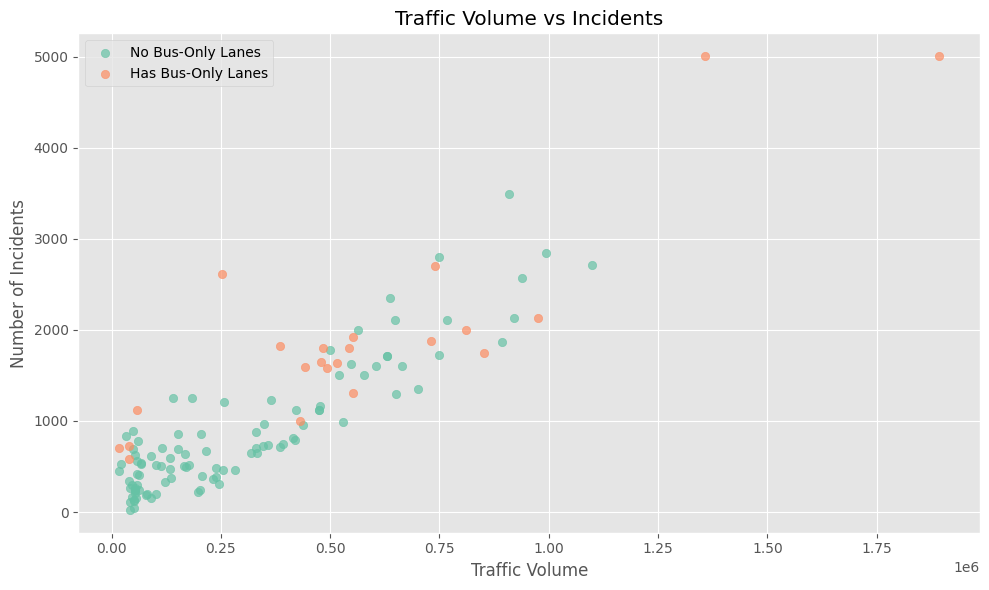

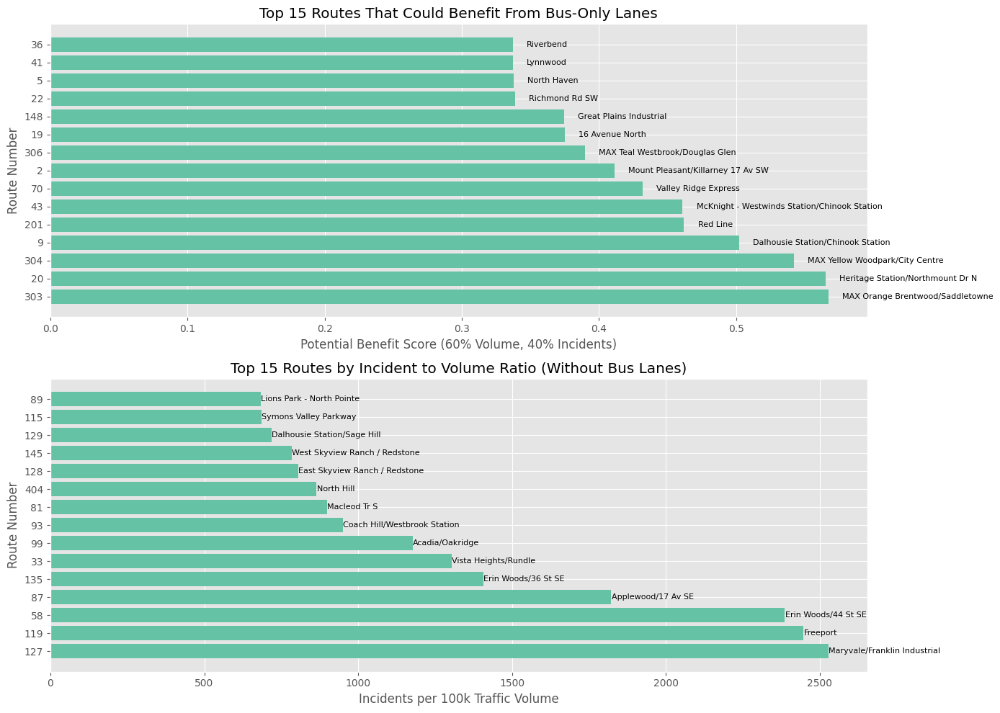


Effect of Bus-Only Lanes on Traffic Metrics:
                         Traffic_Volume                     Incidents          \
                                   mean     median count         mean  median   
Number_of_Bus-Only-Lanes                                                        
0                          2.984391e+05   203225.0   100   736.299213   510.0   
1                          3.619629e+05    58000.0     7  1093.375000   923.0   
2                          5.500925e+05   503500.0    12  1678.692308  1797.0   
3                          1.624880e+06  1624880.0     2  5008.500000  5008.5   
4                          2.526200e+05   252620.0     1  2619.000000  2619.0   

                               Incident_Rate                    
                         count          mean      median count  
Number_of_Bus-Only-Lanes                                        
0                          127     44.467856   27.691335   100  
1                            8    139.676120 

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset
file_path = './analysis-phase-2/zTransit_route_analysis.csv'
df = pd.read_csv(file_path)

# Basic data cleaning and preparation
# Replace zero values in Traffic_Volume with NaN (assuming these are missing values, not actually zero)
df['Traffic_Volume'] = df['Traffic_Volume'].replace(0, np.nan)

# Calculate incident rate (incidents per 10,000 traffic volume)
df['Incident_Rate'] = df['Incidents'] * 10000 / df['Traffic_Volume']

# Print basic statistics
print("Dataset Overview:")
print(f"Total routes: {len(df)}")
print(f"Routes with bus-only lanes: {df['Number_of_Bus-Only-Lanes'].astype(bool).sum()}")
print(f"Routes without bus-only lanes: {(df['Number_of_Bus-Only-Lanes'] == 0).sum()}")
print("\nTraffic Volume Statistics:")
print(df['Traffic_Volume'].describe())
print("\nIncidents Statistics:")
print(df['Incidents'].describe())

# Create a figure with multiple subplots
# plt.figure(figsize=(18, 12))

# Scatter plot of Traffic Volume vs Incidents, colored by bus-only lanes
# plt.subplot(2, 2, 4)
plt.figure(figsize=(10, 6))
has_bus_lanes = df['Number_of_Bus-Only-Lanes'] > 0
plt.scatter(df[~has_bus_lanes]['Traffic_Volume'], df[~has_bus_lanes]['Incidents'], 
            alpha=0.7, label='No Bus-Only Lanes')
plt.scatter(df[has_bus_lanes]['Traffic_Volume'], df[has_bus_lanes]['Incidents'], 
            alpha=0.7, label='Has Bus-Only Lanes')
plt.title('Traffic Volume vs Incidents')
plt.xlabel('Traffic Volume')
plt.ylabel('Number of Incidents')
plt.legend()

plt.tight_layout()
plt.show()

# Additional analysis: Routes that would benefit most from bus-only lanes
# Create a new figure
plt.figure(figsize=(14, 10))

# Calculate potential benefit score (higher traffic volume and incidents indicate more benefit)
df['Potential_Benefit'] = (df['Traffic_Volume'] / df['Traffic_Volume'].max()) * 0.6 + \
                         (df['Incidents'] / df['Incidents'].max()) * 0.4
df['Incident_Volume_Ratio'] = df['Incidents'] / df['Traffic_Volume'] * 100000  # Incidents per 100k traffic volume

# Filter routes without bus lanes and with non-zero traffic
candidate_routes = df[(df['Number_of_Bus-Only-Lanes'] == 0) & (df['Traffic_Volume'].notna())]

# Sort by potential benefit
top_candidates = candidate_routes.sort_values('Potential_Benefit', ascending=False).head(15)

# Plot top candidates
plt.subplot(2, 1, 1)
bars = plt.barh(top_candidates['Route_Short_Name'].astype(str), top_candidates['Potential_Benefit'])
plt.title('Top 15 Routes That Could Benefit From Bus-Only Lanes')
plt.xlabel('Potential Benefit Score (60% Volume, 40% Incidents)')
plt.ylabel('Route Number')

# Add route names as annotations
for i, bar in enumerate(bars):
    route_name = top_candidates.iloc[i]['Route_Long_Name']
    plt.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height()/2, 
             route_name, va='center', fontsize=8)

# Plot incident to volume ratio
plt.subplot(2, 1, 2)
top_by_ratio = candidate_routes.sort_values('Incident_Volume_Ratio', ascending=False).head(15)
bars = plt.barh(top_by_ratio['Route_Short_Name'].astype(str), top_by_ratio['Incident_Volume_Ratio'])
plt.title('Top 15 Routes by Incident to Volume Ratio (Without Bus Lanes)')
plt.xlabel('Incidents per 100k Traffic Volume')
plt.ylabel('Route Number')

# Add route names as annotations
for i, bar in enumerate(bars):
    route_name = top_by_ratio.iloc[i]['Route_Long_Name']
    plt.text(bar.get_width() + 0.5, bar.get_y() + bar.get_height()/2, 
             route_name, va='center', fontsize=8)

plt.tight_layout()
plt.show()

# Detailed analysis of bus lanes effect on traffic metrics
bus_lanes_effect = df.groupby('Number_of_Bus-Only-Lanes').agg({
    'Traffic_Volume': ['mean', 'median', 'count'],
    'Incidents': ['mean', 'median', 'count'],
    'Incident_Rate': ['mean', 'median', 'count']
}).fillna(0)

print("\nEffect of Bus-Only Lanes on Traffic Metrics:")
print(bus_lanes_effect)


# Print top 10 routes with highest incident rates (without bus lanes)
print("\nTop 10 Routes Without Bus Lanes Having Highest Incident Rates:")
high_incident_routes = df[df['Number_of_Bus-Only-Lanes'] == 0].sort_values('Incident_Rate', ascending=False).head(10)
for _, row in high_incident_routes.iterrows():
    print(f"Route {row['Route_Short_Name']} ({row['Route_Long_Name']}): {row['Incident_Rate']:.2f} incidents per 10k traffic volume")

# Print top 10 routes with highest traffic volumes (without bus lanes)
print("\nTop 10 Routes Without Bus Lanes Having Highest Traffic Volumes:")
high_volume_routes = df[df['Number_of_Bus-Only-Lanes'] == 0].sort_values('Traffic_Volume', ascending=False).head(10)
for _, row in high_volume_routes.iterrows():
    print(f"Route {row['Route_Short_Name']} ({row['Route_Long_Name']}): {row['Traffic_Volume']:,.0f} traffic volume, {row['Incidents']} incidents")

# Analyze high volume, high incident routes without bus lanes
high_priority = df[(df['Number_of_Bus-Only-Lanes'] == 0) & 
                  (df['Traffic_Volume'] > df['Traffic_Volume'].quantile(0.75)) & 
                  (df['Incidents'] > df['Incidents'].quantile(0.75))]

print("\nHigh Priority Routes (High Volume, High Incidents, No Bus Lanes):")
for _, row in high_priority.sort_values('Potential_Benefit', ascending=False).iterrows():
    print(f"Route {row['Route_Short_Name']} ({row['Route_Long_Name']}):")
    print(f"  Traffic Volume: {row['Traffic_Volume']:,.0f}")
    print(f"  Incidents: {row['Incidents']}")
    print(f"  Incidents per 100k volume: {row['Incident_Volume_Ratio']:.2f}")
    print(f"  Potential Benefit Score: {row['Potential_Benefit']:.4f}")
    print()

### General Visualization (not utilized in report, for personal use)

C:\Users\bilal\AppData\Local\Temp\ipykernel_13760\336415831.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='Has_Bus_Lanes', y='Traffic_Volume', data=bus_lane_volume, palette=colors)
C:\Users\bilal\AppData\Local\Temp\ipykernel_13760\336415831.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='Has_Bus_Lanes', y='Incidents', data=bus_lane_incidents, palette=colors)
C:\Users\bilal\AppData\Local\Temp\ipykernel_13760\336415831.py:61: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='Number_of_Bus-Only-Lanes', y='Incident

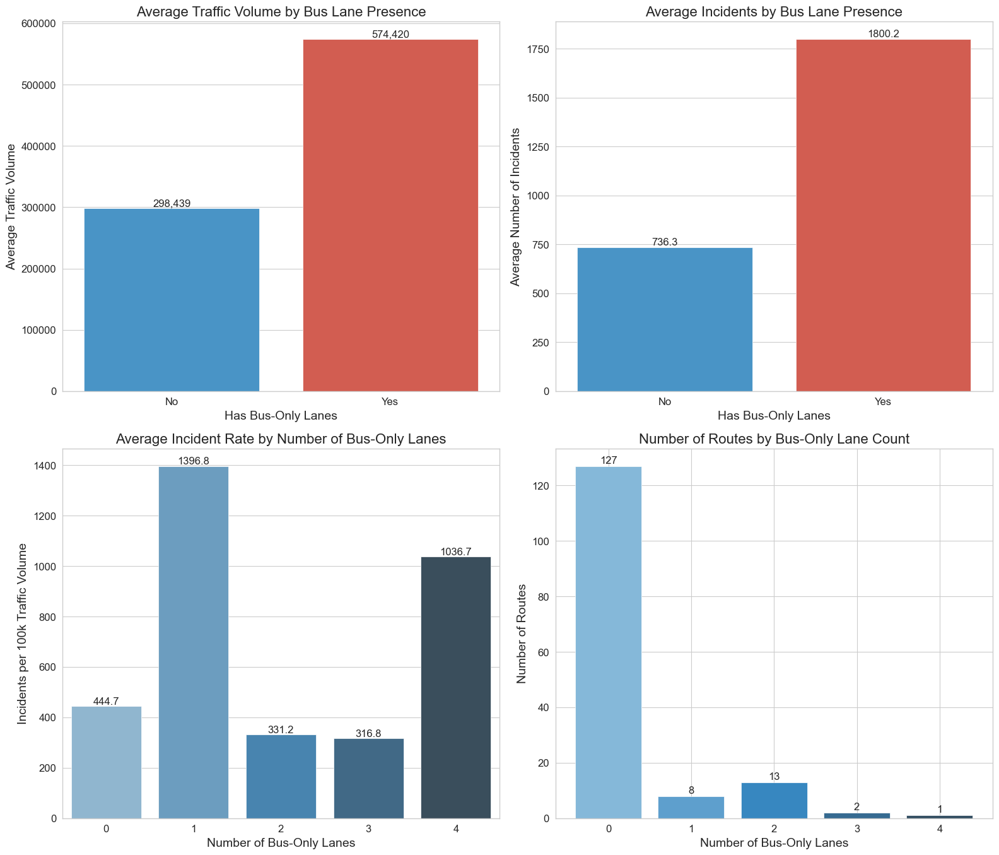

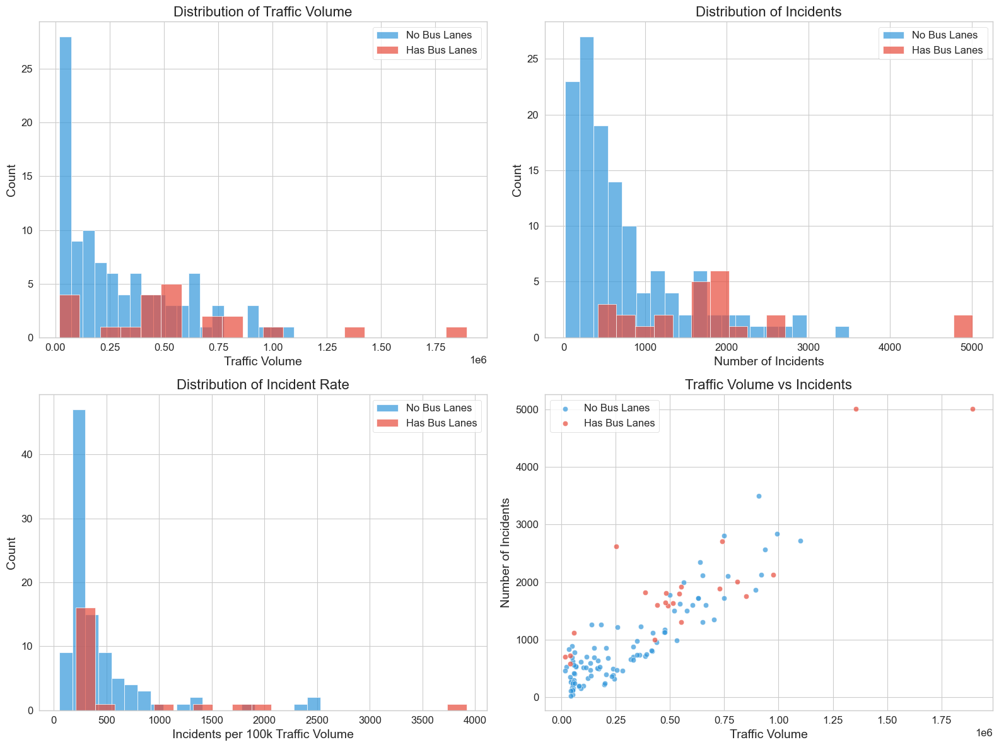

STATISTICAL SUMMARY OF BUS LANE IMPACT

Traffic Volume Statistics:
----------------------------------------
Routes WITHOUT bus lanes (n=100)
  Mean:   298,439.1
  Median: 203,225.0
  Std:    269,021.4

Routes WITH bus lanes (n=22)
  Mean:   574,419.5
  Median: 503,500.0
  Std:    439,119.8

Difference: 275,980.4 (92.5%)

Incident Statistics:
----------------------------------------
Routes WITHOUT bus lanes (n=127)
  Mean:   736.3
  Median: 510.0
  Std:    697.4

Routes WITH bus lanes (n=24)
  Mean:   1,800.2
  Median: 1,698.5
  Std:    1,167.7

Difference: 1,064.0 (144.5%)

Incident Rate Statistics (per 100k traffic volume):
----------------------------------------
Routes WITHOUT bus lanes (n=100)
  Mean:   444.7
  Median: 276.9
  Std:    455.8

Routes WITH bus lanes (n=22)
  Mean:   701.0
  Median: 345.8
  Std:    885.2

Difference: 256.3 (57.6%)


In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset
file_path = './analysis-phase-2/zTransit_route_analysis.csv'
df = pd.read_csv(file_path)

# Data cleaning: Replace zero values in Traffic_Volume with NaN
df['Traffic_Volume'] = df['Traffic_Volume'].replace(0, np.nan)

# Create a binary feature for having bus lanes or not
df['Has_Bus_Lanes'] = df['Number_of_Bus-Only-Lanes'] > 0

# Calculate some derived metrics
df['Incident_Rate'] = df['Incidents'] * 100000 / df['Traffic_Volume']  # Incidents per 100k traffic volume

# Set up a nicer visual style
sns.set_style("whitegrid")
plt.rcParams.update({'font.size': 12})
colors = ['#3498db', '#e74c3c']  # Blue and red

# Create a figure with multiple visualizations
plt.figure(figsize=(16, 20))

# 1. Simple bar chart - Average Traffic Volume by Bus Lane Presence
plt.subplot(3, 2, 1)
bus_lane_volume = df.groupby('Has_Bus_Lanes')['Traffic_Volume'].mean().reset_index()
ax = sns.barplot(x='Has_Bus_Lanes', y='Traffic_Volume', data=bus_lane_volume, palette=colors)
plt.title('Average Traffic Volume by Bus Lane Presence', fontsize=16)
plt.xlabel('Has Bus-Only Lanes', fontsize=14)
plt.ylabel('Average Traffic Volume', fontsize=14)
plt.xticks([0, 1], ['No', 'Yes'])

# Add values on top of bars
for i, p in enumerate(ax.patches):
    ax.annotate(f'{p.get_height():,.0f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'bottom', fontsize=12)

# 2. Simple bar chart - Average Incidents by Bus Lane Presence
plt.subplot(3, 2, 2)
bus_lane_incidents = df.groupby('Has_Bus_Lanes')['Incidents'].mean().reset_index()
ax = sns.barplot(x='Has_Bus_Lanes', y='Incidents', data=bus_lane_incidents, palette=colors)
plt.title('Average Incidents by Bus Lane Presence', fontsize=16)
plt.xlabel('Has Bus-Only Lanes', fontsize=14)
plt.ylabel('Average Number of Incidents', fontsize=14)
plt.xticks([0, 1], ['No', 'Yes'])

# Add values on top of bars
for i, p in enumerate(ax.patches):
    ax.annotate(f'{p.get_height():.1f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'bottom', fontsize=12)

# 3. Bar chart - Average Incident Rate by Number of Bus Lanes
plt.subplot(3, 2, 3)
bus_lane_incident_rate = df.groupby('Number_of_Bus-Only-Lanes')['Incident_Rate'].mean().reset_index()
bus_lane_incident_rate = bus_lane_incident_rate.sort_values('Number_of_Bus-Only-Lanes')
ax = sns.barplot(x='Number_of_Bus-Only-Lanes', y='Incident_Rate', data=bus_lane_incident_rate, 
                 palette=sns.color_palette("Blues_d", len(bus_lane_incident_rate)))
plt.title('Average Incident Rate by Number of Bus-Only Lanes', fontsize=16)
plt.xlabel('Number of Bus-Only Lanes', fontsize=14)
plt.ylabel('Incidents per 100k Traffic Volume', fontsize=14)

# Add values on top of bars
for i, p in enumerate(ax.patches):
    ax.annotate(f'{p.get_height():.1f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'bottom', fontsize=12)

# 4. Bar chart - Count of Routes by Number of Bus Lanes
plt.subplot(3, 2, 4)
bus_lane_counts = df['Number_of_Bus-Only-Lanes'].value_counts().sort_index()
ax = plt.bar(bus_lane_counts.index, bus_lane_counts.values, color=sns.color_palette("Blues_d", len(bus_lane_counts)))
plt.title('Number of Routes by Bus-Only Lane Count', fontsize=16)
plt.xlabel('Number of Bus-Only Lanes', fontsize=14)
plt.ylabel('Number of Routes', fontsize=14)
plt.xticks(bus_lane_counts.index)

# Add count labels on top of bars
for i, v in enumerate(bus_lane_counts.values):
    plt.text(bus_lane_counts.index[i], v + 1, str(v), ha='center')


plt.tight_layout()
plt.show()

# Create another figure for comparative distribution analysis
plt.figure(figsize=(16, 12))

# 7. Comparative histograms - Traffic Volume
plt.subplot(2, 2, 1)
sns.histplot(data=df[~df['Has_Bus_Lanes']], x='Traffic_Volume', bins=20, 
             color=colors[0], alpha=0.7, label='No Bus Lanes')
sns.histplot(data=df[df['Has_Bus_Lanes']], x='Traffic_Volume', bins=20, 
             color=colors[1], alpha=0.7, label='Has Bus Lanes')
plt.title('Distribution of Traffic Volume', fontsize=16)
plt.xlabel('Traffic Volume', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend()

# 8. Comparative histograms - Incidents
plt.subplot(2, 2, 2)
sns.histplot(data=df[~df['Has_Bus_Lanes']], x='Incidents', bins=20, 
             color=colors[0], alpha=0.7, label='No Bus Lanes')
sns.histplot(data=df[df['Has_Bus_Lanes']], x='Incidents', bins=20, 
             color=colors[1], alpha=0.7, label='Has Bus Lanes')
plt.title('Distribution of Incidents', fontsize=16)
plt.xlabel('Number of Incidents', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend()

# 9. Comparative histograms - Incident Rate
plt.subplot(2, 2, 3)
sns.histplot(data=df[~df['Has_Bus_Lanes']], x='Incident_Rate', bins=20, 
             color=colors[0], alpha=0.7, label='No Bus Lanes')
sns.histplot(data=df[df['Has_Bus_Lanes']], x='Incident_Rate', bins=20, 
             color=colors[1], alpha=0.7, label='Has Bus Lanes')
plt.title('Distribution of Incident Rate', fontsize=16)
plt.xlabel('Incidents per 100k Traffic Volume', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend()

# 10. Scatter plot - Traffic Volume vs Incidents
plt.subplot(2, 2, 4)
sns.scatterplot(data=df[~df['Has_Bus_Lanes']], x='Traffic_Volume', y='Incidents', 
                color=colors[0], alpha=0.7, label='No Bus Lanes')
sns.scatterplot(data=df[df['Has_Bus_Lanes']], x='Traffic_Volume', y='Incidents', 
                color=colors[1], alpha=0.7, label='Has Bus Lanes')
plt.title('Traffic Volume vs Incidents', fontsize=16)
plt.xlabel('Traffic Volume', fontsize=14)
plt.ylabel('Number of Incidents', fontsize=14)
plt.legend()

plt.tight_layout()
plt.show()

# Statistical summary of the comparisons
print("STATISTICAL SUMMARY OF BUS LANE IMPACT")
print("=" * 40)

# Group by presence of bus lanes
bus_lane_stats = df.groupby('Has_Bus_Lanes').agg({
    'Traffic_Volume': ['mean', 'median', 'std', 'count'],
    'Incidents': ['mean', 'median', 'std', 'count'],
    'Incident_Rate': ['mean', 'median', 'std', 'count']
})

# Print formatted statistics
print("\nTraffic Volume Statistics:")
print("-" * 40)
print(f"Routes WITHOUT bus lanes (n={bus_lane_stats.loc[False, ('Traffic_Volume', 'count')]})")
print(f"  Mean:   {bus_lane_stats.loc[False, ('Traffic_Volume', 'mean')]:,.1f}")
print(f"  Median: {bus_lane_stats.loc[False, ('Traffic_Volume', 'median')]:,.1f}")
print(f"  Std:    {bus_lane_stats.loc[False, ('Traffic_Volume', 'std')]:,.1f}")

print(f"\nRoutes WITH bus lanes (n={bus_lane_stats.loc[True, ('Traffic_Volume', 'count')]})")
print(f"  Mean:   {bus_lane_stats.loc[True, ('Traffic_Volume', 'mean')]:,.1f}")
print(f"  Median: {bus_lane_stats.loc[True, ('Traffic_Volume', 'median')]:,.1f}")
print(f"  Std:    {bus_lane_stats.loc[True, ('Traffic_Volume', 'std')]:,.1f}")

volume_diff = bus_lane_stats.loc[True, ('Traffic_Volume', 'mean')] - bus_lane_stats.loc[False, ('Traffic_Volume', 'mean')]
volume_pct = (volume_diff / bus_lane_stats.loc[False, ('Traffic_Volume', 'mean')]) * 100
print(f"\nDifference: {volume_diff:,.1f} ({volume_pct:.1f}%)")

print("\nIncident Statistics:")
print("-" * 40)
print(f"Routes WITHOUT bus lanes (n={bus_lane_stats.loc[False, ('Incidents', 'count')]})")
print(f"  Mean:   {bus_lane_stats.loc[False, ('Incidents', 'mean')]:,.1f}")
print(f"  Median: {bus_lane_stats.loc[False, ('Incidents', 'median')]:,.1f}")
print(f"  Std:    {bus_lane_stats.loc[False, ('Incidents', 'std')]:,.1f}")

print(f"\nRoutes WITH bus lanes (n={bus_lane_stats.loc[True, ('Incidents', 'count')]})")
print(f"  Mean:   {bus_lane_stats.loc[True, ('Incidents', 'mean')]:,.1f}")
print(f"  Median: {bus_lane_stats.loc[True, ('Incidents', 'median')]:,.1f}")
print(f"  Std:    {bus_lane_stats.loc[True, ('Incidents', 'std')]:,.1f}")

incidents_diff = bus_lane_stats.loc[True, ('Incidents', 'mean')] - bus_lane_stats.loc[False, ('Incidents', 'mean')]
incidents_pct = (incidents_diff / bus_lane_stats.loc[False, ('Incidents', 'mean')]) * 100
print(f"\nDifference: {incidents_diff:,.1f} ({incidents_pct:.1f}%)")

print("\nIncident Rate Statistics (per 100k traffic volume):")
print("-" * 40)
print(f"Routes WITHOUT bus lanes (n={bus_lane_stats.loc[False, ('Incident_Rate', 'count')]})")
print(f"  Mean:   {bus_lane_stats.loc[False, ('Incident_Rate', 'mean')]:,.1f}")
print(f"  Median: {bus_lane_stats.loc[False, ('Incident_Rate', 'median')]:,.1f}")
print(f"  Std:    {bus_lane_stats.loc[False, ('Incident_Rate', 'std')]:,.1f}")

print(f"\nRoutes WITH bus lanes (n={bus_lane_stats.loc[True, ('Incident_Rate', 'count')]})")
print(f"  Mean:   {bus_lane_stats.loc[True, ('Incident_Rate', 'mean')]:,.1f}")
print(f"  Median: {bus_lane_stats.loc[True, ('Incident_Rate', 'median')]:,.1f}")
print(f"  Std:    {bus_lane_stats.loc[True, ('Incident_Rate', 'std')]:,.1f}")

rate_diff = bus_lane_stats.loc[True, ('Incident_Rate', 'mean')] - bus_lane_stats.loc[False, ('Incident_Rate', 'mean')]
rate_pct = (rate_diff / bus_lane_stats.loc[False, ('Incident_Rate', 'mean')]) * 100
print(f"\nDifference: {rate_diff:,.1f} ({rate_pct:.1f}%)")

### Regression Analysis

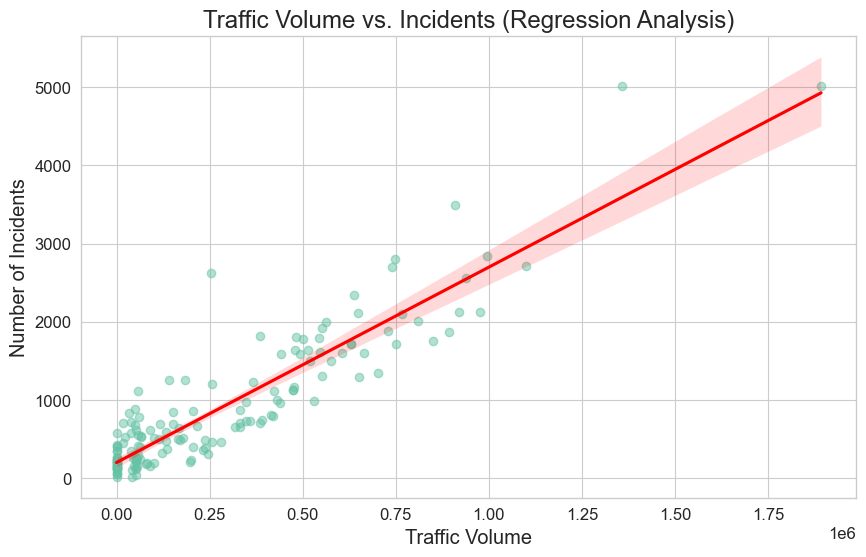

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def analyze_transit_data(file_path):
    # Load data
    df = pd.read_csv(file_path)
    
    # Add a column to indicate whether a route has bus-only lanes
    df["Has_Bus_Only_Lanes"] = df["Number_of_Bus-Only-Lanes"] > 0
    
    # 1. Regression Plot: Traffic Volume vs. Incidents
    plt.figure(figsize=(10, 6))
    sns.regplot(data=df, x="Traffic_Volume", y="Incidents", scatter_kws={'alpha':0.5}, line_kws={"color":"red"})
    plt.title("Traffic Volume vs. Incidents (Regression Analysis)")
    plt.xlabel("Traffic Volume")
    plt.ylabel("Number of Incidents")
    plt.show()
file_path = './analysis-phase-2/zTransit_route_analysis.csv'
analyze_transit_data(file_path)

# Route Recommendations - without CT-GTFS

<Figure size 1400x1000 with 0 Axes>

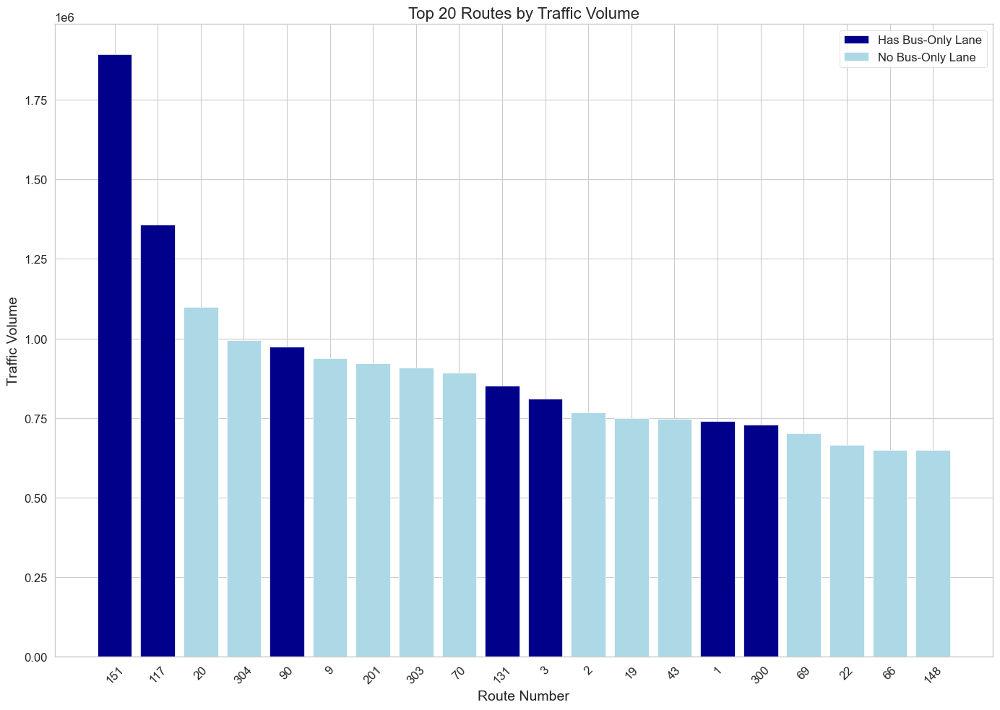

<Figure size 1400x1000 with 0 Axes>

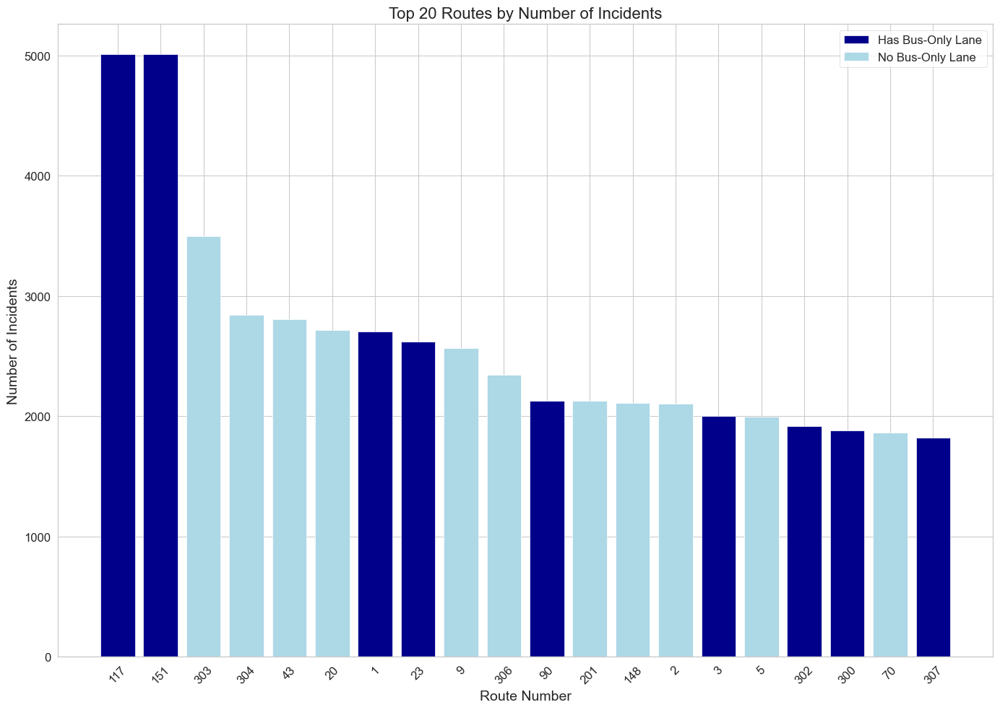

<Figure size 1400x1000 with 0 Axes>

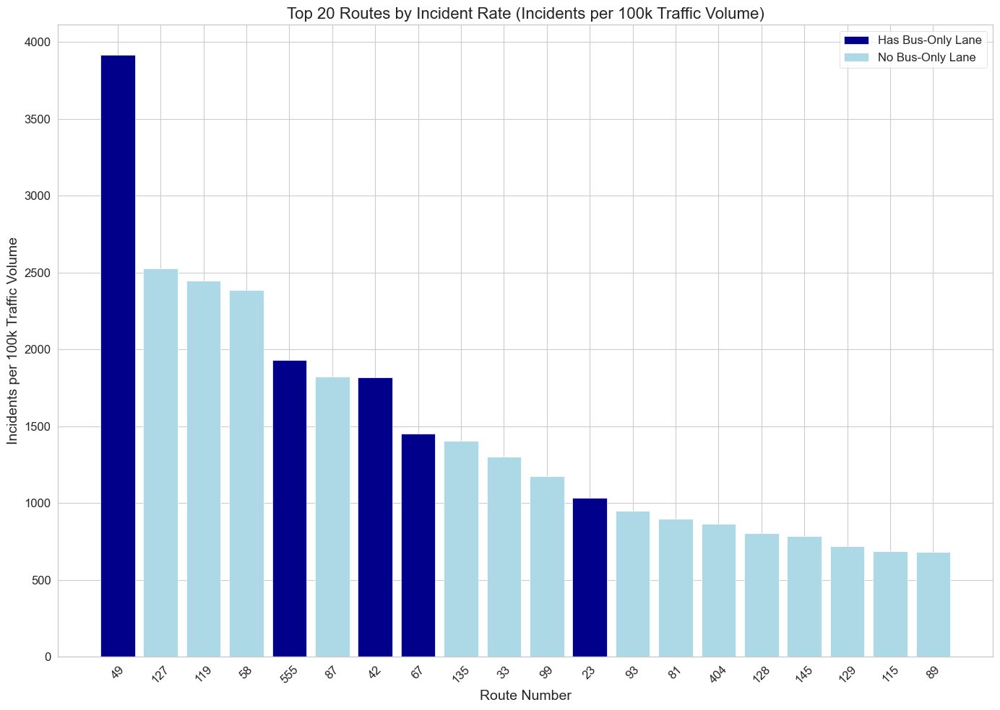

<Figure size 1600x1200 with 0 Axes>

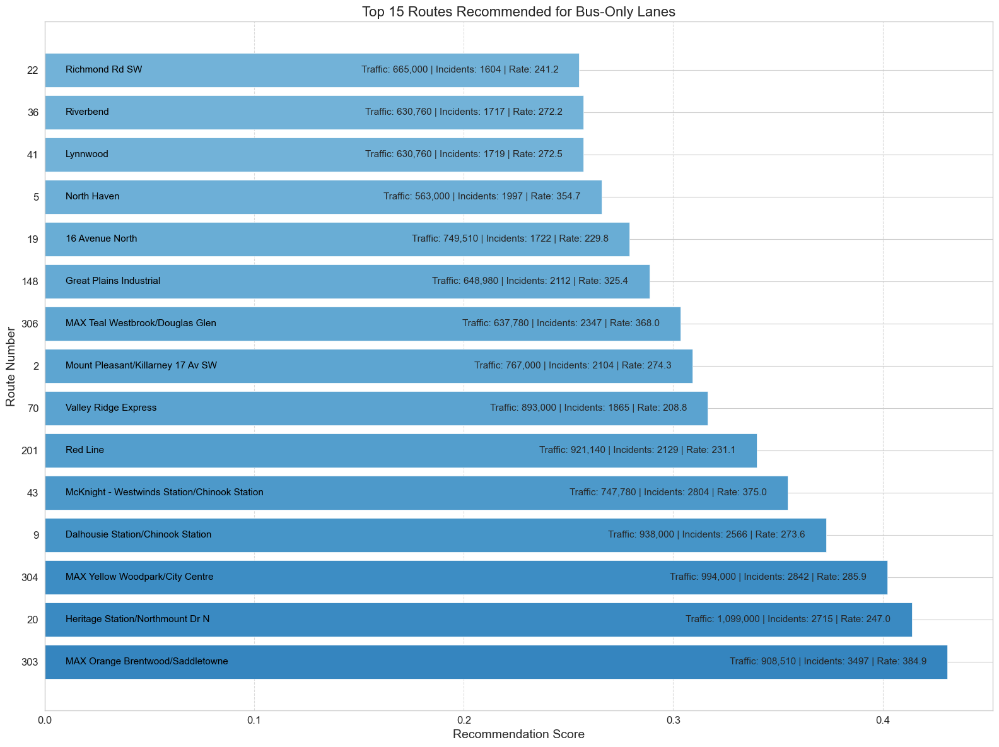


=== TRANSIT ROUTE ANALYSIS SUMMARY ===
Total routes analyzed: 151
Routes with bus-only lanes: 24
Routes without bus-only lanes: 127

Average metrics for routes WITH bus-only lanes:
- Traffic Volume: 526551.2
- Incidents: 1800.2
- Incidents per 100k Traffic: 642.60

Average metrics for routes WITHOUT bus-only lanes:
- Traffic Volume: 234991.4
- Incidents: 736.3
- Incidents per 100k Traffic: 350.14

Top 5 routes recommended for new bus-only lanes:
1. Route 303 (MAX Orange Brentwood/Saddletowne)
   Traffic Volume: 908510
   Incidents: 3497
   Incidents per 100k: 384.92
   Recommendation Score: 0.431
2. Route 20 (Heritage Station/Northmount Dr N)
   Traffic Volume: 1099000
   Incidents: 2715
   Incidents per 100k: 247.04
   Recommendation Score: 0.414
3. Route 304 (MAX Yellow Woodpark/City Centre)
   Traffic Volume: 994000
   Incidents: 2842
   Incidents per 100k: 285.92
   Recommendation Score: 0.402
4. Route 9 (Dalhousie Station/Chinook Station)
   Traffic Volume: 938000
   Incidents: 2

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os

# Load the data
file_path = './analysis-phase-2/zTransit_route_analysis.csv'

# Data cleaning and preparation
df['Traffic_Volume'] = pd.to_numeric(df['Traffic_Volume'], errors='coerce')
df['Incidents'] = pd.to_numeric(df['Incidents'], errors='coerce')
df['Number_of_Bus-Only-Lanes'] = pd.to_numeric(df['Number_of_Bus-Only-Lanes'], errors='coerce')

# Fill any NaN values with 0 (for routes with missing data)
df.fillna(0, inplace=True)

# Create a binary column for routes with bus-only lanes
df['Has_Bus_Lane'] = df['Number_of_Bus-Only-Lanes'] > 0

# Calculate incidents per 100,000 traffic volume (safety metric)
df['Incidents_per_100k'] = df.apply(
    lambda x: (x['Incidents'] / x['Traffic_Volume'] * 100000) if x['Traffic_Volume'] > 0 else 0, 
    axis=1
)

# Function to set up the plot style
def setup_plot_style():
    plt.style.use('seaborn-v0_8-dark-palette')
    plt.rcParams['figure.figsize'] = (12, 8)
    plt.rcParams['font.size'] = 12
    plt.rcParams['axes.titlesize'] = 16
    plt.rcParams['axes.labelsize'] = 14
    plt.rcParams['xtick.labelsize'] = 12
    plt.rcParams['ytick.labelsize'] = 12

# Create a directory for saving plots
if not os.path.exists('transit_analysis_plots'):
    os.makedirs('transit_analysis_plots')

# Common legend elements
from matplotlib.patches import Patch
legend_elements = [
    Patch(facecolor='darkblue', label='Has Bus-Only Lane'),
    Patch(facecolor='lightblue', label='No Bus-Only Lane')
]

# VISUALIZATION 5: Top 20 routes by traffic volume
setup_plot_style()
plt.figure(figsize=(14, 10))

# Create a copy of df to avoid warnings about modifying data
top_by_traffic = df.sort_values('Traffic_Volume', ascending=False).head(20).copy()

# Create the plot manually to ensure correct bar colors
fig, ax = plt.subplots(figsize=(14, 10))
x = np.arange(len(top_by_traffic))
width = 0.8

# Create bars with colors based on Has_Bus_Lane
bars = []
for i, (_, row) in enumerate(top_by_traffic.iterrows()):
    color = 'darkblue' if row['Has_Bus_Lane'] else 'lightblue'
    bar = ax.bar(i, row['Traffic_Volume'], width, color=color)
    bars.append(bar)

# Set x-axis labels
ax.set_xticks(x)
ax.set_xticklabels(top_by_traffic['Route_Short_Name'], rotation=45)

# Add titles and labels
ax.set_title('Top 20 Routes by Traffic Volume')
ax.set_xlabel('Route Number')
ax.set_ylabel('Traffic Volume')
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()
# plt.savefig('transit_analysis_plots/top_routes_by_traffic.png', dpi=300, bbox_inches='tight')
plt.close()

# VISUALIZATION 6: Top 20 routes by incidents
setup_plot_style()
plt.figure(figsize=(14, 10))

# Create a copy of df to avoid warnings about modifying data
top_by_incidents = df.sort_values('Incidents', ascending=False).head(20).copy()

# Create the plot manually to ensure correct bar colors
fig, ax = plt.subplots(figsize=(14, 10))
x = np.arange(len(top_by_incidents))
width = 0.8

# Create bars with colors based on Has_Bus_Lane
bars = []
for i, (_, row) in enumerate(top_by_incidents.iterrows()):
    color = 'darkblue' if row['Has_Bus_Lane'] else 'lightblue'
    bar = ax.bar(i, row['Incidents'], width, color=color)
    bars.append(bar)

# Set x-axis labels
ax.set_xticks(x)
ax.set_xticklabels(top_by_incidents['Route_Short_Name'], rotation=45)

# Add titles and labels
ax.set_title('Top 20 Routes by Number of Incidents')
ax.set_xlabel('Route Number')
ax.set_ylabel('Number of Incidents')
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()
# plt.savefig('transit_analysis_plots/top_routes_by_incidents.png', dpi=300, bbox_inches='tight')
plt.close()

# VISUALIZATION 7: Top 20 routes by incident rate
setup_plot_style()
plt.figure(figsize=(14, 10))

# Filter out routes with zero traffic volume to avoid division by zero issues
df_nonzero_traffic = df[df['Traffic_Volume'] > 0].copy()
top_by_incident_rate = df_nonzero_traffic.sort_values('Incidents_per_100k', ascending=False).head(20).copy()

# Create the plot manually to ensure correct bar colors
fig, ax = plt.subplots(figsize=(14, 10))
x = np.arange(len(top_by_incident_rate))
width = 0.8

# Create bars with colors based on Has_Bus_Lane
bars = []
for i, (_, row) in enumerate(top_by_incident_rate.iterrows()):
    color = 'darkblue' if row['Has_Bus_Lane'] else 'lightblue'
    bar = ax.bar(i, row['Incidents_per_100k'], width, color=color)
    bars.append(bar)

# Set x-axis labels
ax.set_xticks(x)
ax.set_xticklabels(top_by_incident_rate['Route_Short_Name'], rotation=45)

# Add titles and labels
ax.set_title('Top 20 Routes by Incident Rate (Incidents per 100k Traffic Volume)')
ax.set_xlabel('Route Number')
ax.set_ylabel('Incidents per 100k Traffic Volume')
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()
# plt.savefig('transit_analysis_plots/top_routes_by_incident_rate.png', dpi=300, bbox_inches='tight')
plt.close()

# Original pie chart visualization (keeping for reference)
setup_plot_style()
plt.figure(figsize=(10, 10))
bus_lane_counts = df['Number_of_Bus-Only-Lanes'].value_counts().sort_index()
plt.pie(bus_lane_counts, labels=[f'{i} Bus Lane(s): {count} routes' for i, count in enumerate(bus_lane_counts)], 
        autopct='%1.1f%%', startangle=90, colors=sns.color_palette('Blues', len(bus_lane_counts)))
plt.title('Distribution of Routes by Number of Bus-Only Lanes')
plt.savefig('transit_analysis_plots/bus_lane_distribution.png', dpi=300, bbox_inches='tight')
plt.close()

# ANALYSIS FOR RECOMMENDATIONS: Finding routes that would benefit most from bus-only lanes
# Normalize values for fair comparison
df['Traffic_Volume_Norm'] = df['Traffic_Volume'] / df['Traffic_Volume'].max()
df['Incidents_Norm'] = df['Incidents'] / df['Incidents'].max()
df['Incidents_Rate_Norm'] = df['Incidents_per_100k'] / df['Incidents_per_100k'].max()

# Create recommendation score (only for routes without bus lanes)
df_no_bus_lanes = df[df['Number_of_Bus-Only-Lanes'] == 0].copy()
df_no_bus_lanes['Recommendation_Score'] = (
    df_no_bus_lanes['Traffic_Volume_Norm'] * 0.4 + 
    df_no_bus_lanes['Incidents_Norm'] * 0.3 + 
    df_no_bus_lanes['Incidents_Rate_Norm'] * 0.3
)

# VISUALIZATION 9: Top 15 routes recommended for bus-only lanes
setup_plot_style()
plt.figure(figsize=(16, 12))
top_recommendations = df_no_bus_lanes.sort_values('Recommendation_Score', ascending=False).head(15).copy()

# Create a horizontal bar chart manually
fig, ax = plt.subplots(figsize=(16, 12))
y = np.arange(len(top_recommendations))
width = 0.8

# Create bars with gradient colors
bars = []
for i, (_, row) in enumerate(top_recommendations.iterrows()):
    color = plt.cm.Blues(0.2 + row['Recommendation_Score'] * 1.1)
    bar = ax.barh(i, row['Recommendation_Score'], width, color=color)
    bars.append(bar)

# Set y-axis labels
ax.set_yticks(y)
ax.set_yticklabels(top_recommendations['Route_Short_Name'])

# Add titles and labels
ax.set_title('Top 15 Routes Recommended for Bus-Only Lanes')
ax.set_xlabel('Recommendation Score')
ax.set_ylabel('Route Number')

# Add route names as annotations with better formatting
for i, route in enumerate(top_recommendations.itertuples()):
    # Add route name after the route number
    ax.text(0.01, i, f"{route.Route_Long_Name}", 
            ha='left', va='center', color='black', fontsize=11)
    
    # Add metrics at the end of each bar
    ax.text((route.Recommendation_Score-0.01), i,
            f"Traffic: {route.Traffic_Volume:,.0f} | Incidents: {route.Incidents} | Rate: {route.Incidents_per_100k:.1f}",
            ha='right', va='center', fontsize=11)

plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
# plt.savefig('transit_analysis_plots/top_recommendations.png', dpi=300, bbox_inches='tight')
plt.close()

# Generate a detailed recommendation report
top_recommendations_df = top_recommendations[['Route_Short_Name', 'Route_Long_Name', 
                                             'Traffic_Volume', 'Incidents', 
                                             'Incidents_per_100k', 'Recommendation_Score']].copy()

# Format and save the recommendation report as CSV
top_recommendations_df.to_csv('transit_analysis_plots/bus_lane_recommendations.csv', index=False)

# Print some summary statistics
print("\n=== TRANSIT ROUTE ANALYSIS SUMMARY ===")
print(f"Total routes analyzed: {len(df)}")
print(f"Routes with bus-only lanes: {len(df[df['Has_Bus_Lane']])}")
print(f"Routes without bus-only lanes: {len(df[~df['Has_Bus_Lane']])}")
print("\nAverage metrics for routes WITH bus-only lanes:")
print(f"- Traffic Volume: {df[df['Has_Bus_Lane']]['Traffic_Volume'].mean():.1f}")
print(f"- Incidents: {df[df['Has_Bus_Lane']]['Incidents'].mean():.1f}")
print(f"- Incidents per 100k Traffic: {df[df['Has_Bus_Lane']]['Incidents_per_100k'].mean():.2f}")
print("\nAverage metrics for routes WITHOUT bus-only lanes:")
print(f"- Traffic Volume: {df[~df['Has_Bus_Lane']]['Traffic_Volume'].mean():.1f}")
print(f"- Incidents: {df[~df['Has_Bus_Lane']]['Incidents'].mean():.1f}")
print(f"- Incidents per 100k Traffic: {df[~df['Has_Bus_Lane']]['Incidents_per_100k'].mean():.2f}")
print("\nTop 5 routes recommended for new bus-only lanes:")
for i, route in enumerate(top_recommendations.head().itertuples(), 1):
    print(f"{i}. Route {route.Route_Short_Name} ({route.Route_Long_Name})")
    print(f"   Traffic Volume: {route.Traffic_Volume:.0f}")
    print(f"   Incidents: {route.Incidents}")
    print(f"   Incidents per 100k: {route.Incidents_per_100k:.2f}")
    print(f"   Recommendation Score: {route.Recommendation_Score:.3f}")
# print("\nAnalysis complete! All visualizations saved to the 'transit_analysis_plots'")
print("\n Analysis compleete")

In [3]:
plt.style.available

['Solarize_Light2',
 '_classic_test_patch',
 '_mpl-gallery',
 '_mpl-gallery-nogrid',
 'bmh',
 'classic',
 'dark_background',
 'fast',
 'fivethirtyeight',
 'ggplot',
 'grayscale',
 'petroff10',
 'seaborn-v0_8',
 'seaborn-v0_8-bright',
 'seaborn-v0_8-colorblind',
 'seaborn-v0_8-dark',
 'seaborn-v0_8-dark-palette',
 'seaborn-v0_8-darkgrid',
 'seaborn-v0_8-deep',
 'seaborn-v0_8-muted',
 'seaborn-v0_8-notebook',
 'seaborn-v0_8-paper',
 'seaborn-v0_8-pastel',
 'seaborn-v0_8-poster',
 'seaborn-v0_8-talk',
 'seaborn-v0_8-ticks',
 'seaborn-v0_8-white',
 'seaborn-v0_8-whitegrid',
 'tableau-colorblind10']